IMPORTING LIBRARIES:

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, roc_auc_score, confusion_matrix


LOADING DATA:

In [2]:
ds=pd.read_csv(r"/Users/Mouna_sk2005/Downloads/archive/fraudTrain.csv")

In [3]:
df=pd.DataFrame(ds)

In [4]:
le=LabelEncoder()


In [5]:
for column in df.select_dtypes(include=['object']).columns:
    df[column]=le.fit_transform(df[column])

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1296675 entries, 0 to 1296674
Data columns (total 23 columns):
 #   Column                 Non-Null Count    Dtype  
---  ------                 --------------    -----  
 0   Unnamed: 0             1296675 non-null  int64  
 1   trans_date_trans_time  1296675 non-null  int64  
 2   cc_num                 1296675 non-null  int64  
 3   merchant               1296675 non-null  int64  
 4   category               1296675 non-null  int64  
 5   amt                    1296675 non-null  float64
 6   first                  1296675 non-null  int64  
 7   last                   1296675 non-null  int64  
 8   gender                 1296675 non-null  int64  
 9   street                 1296675 non-null  int64  
 10  city                   1296675 non-null  int64  
 11  state                  1296675 non-null  int64  
 12  zip                    1296675 non-null  int64  
 13  lat                    1296675 non-null  float64
 14  long              

VISUALISING THE DATA:

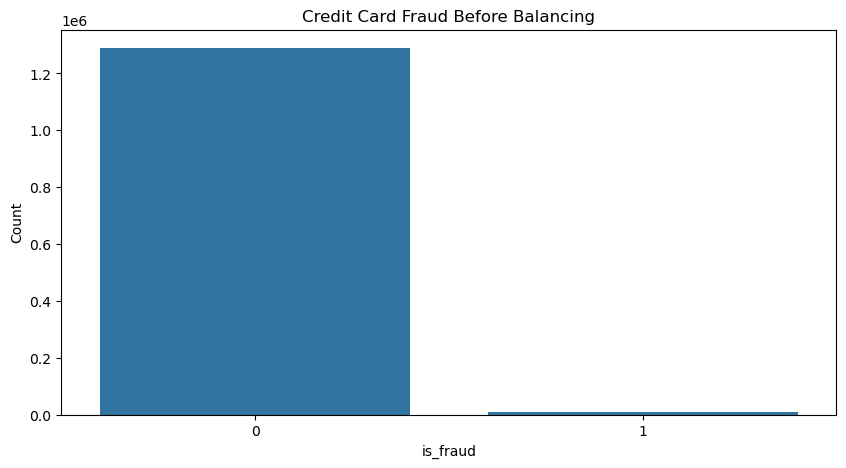

In [7]:
plt.figure(figsize=(10, 5))
sns.countplot(x='is_fraud', data=df)
plt.title('Credit Card Fraud Before Balancing')
plt.xlabel('is_fraud')
plt.ylabel('Count')
plt.show()

In [8]:
x = df.drop('is_fraud', axis=1)
y = df['is_fraud']

In [9]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.3,random_state=42)

In [10]:
smote = SMOTE(random_state=42)
x_train_balanced, y_train_balanced = smote.fit_resample(x_train, y_train)

In [11]:
print(y_train_balanced.value_counts())

is_fraud
0    902451
1    902451
Name: count, dtype: int64


BALANCING THE DATA:

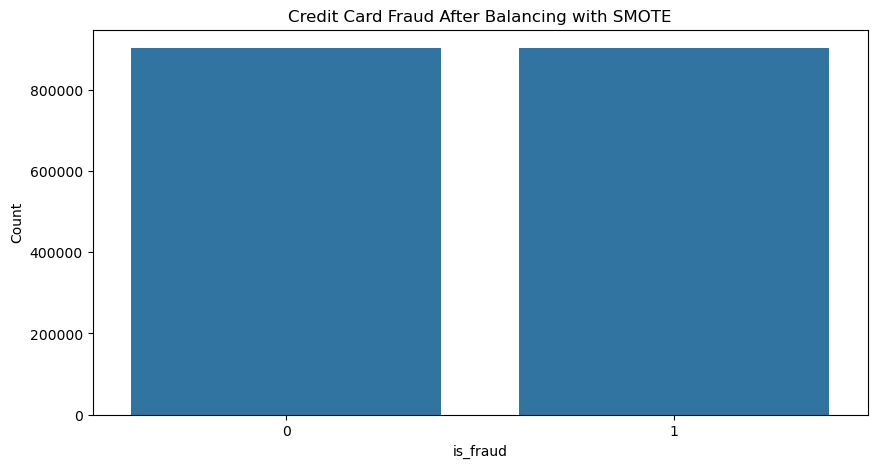

In [12]:
y_train_balanced_df = pd.DataFrame(y_train_balanced, columns=['is_fraud'])
plt.figure(figsize=(10, 5))
sns.countplot(x='is_fraud', data=y_train_balanced_df)
plt.title('Credit Card Fraud After Balancing with SMOTE')
plt.xlabel('is_fraud')
plt.ylabel('Count')
plt.show()


In [13]:
from sklearn.preprocessing import StandardScaler
st=StandardScaler()
x_train=st.fit_transform(x_train)
x_test=st.transform(x_test)

TRAINING DECISION TREE MODEL:

In [14]:
from sklearn.tree import DecisionTreeClassifier
lr=DecisionTreeClassifier()
lr.fit(x_train_balanced,y_train_balanced)

DecisionTreeClassifier()

In [15]:
y_pred=lr.predict(x_test)

/opt/anaconda3/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


In [16]:
cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:\n", cm)


Confusion Matrix:
 [[386643     75]
 [  2285      0]]


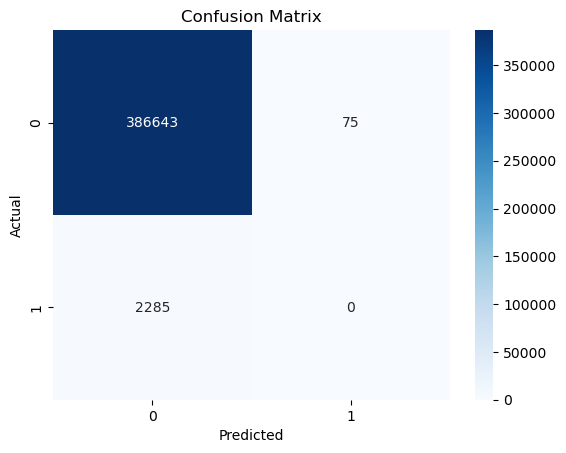

In [17]:
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [18]:
df.corr()

,Unnamed: 0,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,...,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
Unnamed: 0,1.000000e+00,9.999995e-01,0.000386,-0.000972,0.000250,-0.000251,0.000509,0.000121,-0.000945,-0.001067,...,0.000602,-0.000676,-0.001678,-7.800295e-07,0.003712,-0.000595,0.998971,0.000541,-0.000671,-0.004767
trans_date_trans_time,9.999995e-01,1.000000e+00,0.000385,-0.000972,0.000249,-0.000253,0.000509,0.000121,-0.000946,-0.001066,...,0.000601,-0.000676,-0.001679,2.072173e-07,0.003709,-0.000596,0.999007,0.000540,-0.000671,-0.004777
cc_num,3.857663e-04,3.850884e-04,1.000000,0.000055,0.001230,0.001769,-0.027189,0.006908,0.001112,0.046509,...,-0.059271,-0.048278,-0.008991,2.916472e-02,0.002397,0.001415,0.000354,-0.058942,-0.048252,-0.000981
merchant,-9.718206e-04,-9.722603e-04,0.000055,1.000000,0.032302,-0.002633,-0.001576,-0.000439,-0.000915,0.000718,...,-0.002266,-0.000697,0.001911,1.360387e-03,0.006798,-0.000459,-0.000999,-0.002263,-0.000673,-0.000536
category,2.495622e-04,2.493803e-04,0.001230,0.032302,1.000000,0.030867,-0.001931,-0.004319,-0.028259,0.002258,...,-0.008660,-0.000767,0.009386,3.490427e-03,0.004347,-0.000356,0.000182,-0.008519,-0.000736,0.020205
amt,-2.511725e-04,-2.525355e-04,0.001769,-0.002633,0.030867,1.000000,-0.003575,-0.004708,0.001034,0.001346,...,-0.001926,-0.000187,0.005818,-6.277082e-04,0.010650,-0.001297,-0.000293,-0.001873,-0.000151,0.219404
first,5.093514e-04,5.086892e-04,-0.027189,-0.001576,-0.001931,-0.003575,1.000000,-0.056983,0.015197,-0.045369,...,0.131869,-0.016475,-0.066607,-3.968275e-02,0.004203,0.000878,0.000483,0.130964,-0.016489,-0.003219
last,1.213636e-04,1.214824e-04,0.006908,-0.000439,-0.004319,-0.004708,-0.056983,1.000000,0.043740,0.005634,...,-0.034915,-0.025557,-0.012039,-2.459638e-02,-0.019168,0.000153,0.000094,-0.034548,-0.025557,-0.000096
gender,-9.450357e-04,-9.457053e-04,0.001112,-0.000915,-0.028259,0.001034,0.015197,0.043740,1.000000,0.042679,...,0.042935,0.050404,-0.028649,-7.990836e-02,-0.012185,-0.000289,-0.000960,0.042645,0.050350,0.007642
street,-1.066586e-03,-1.066480e-03,0.046509,0.000718,0.002258,0.001346,-0.045369,0.005634,0.042679,1.000000,...,-0.012651,0.071328,-0.012530,-2.022876e-02,-0.042514,-0.001430,-0.001089,-0.012517,0.071286,0.001448


In [19]:
y_pred_proba = lr.predict_proba(x_test)[:, 1]
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("\nClassification Report:\n", classification_report(y_test, y_pred))
print("ROC-AUC Score:", roc_auc_score(y_test, y_pred_proba))

/opt/anaconda3/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


Confusion Matrix:
 [[386643     75]
 [  2285      0]]

Classification Report:
               precision    recall  f1-score   support

           0       0.99      1.00      1.00    386718
           1       0.00      0.00      0.00      2285

    accuracy                           0.99    389003
   macro avg       0.50      0.50      0.50    389003
weighted avg       0.99      0.99      0.99    389003

ROC-AUC Score: 0.4999030301149675


In [20]:
a=accuracy_score(y_pred,y_test)
print("The accuracy score (in %) is:",a*100)

The accuracy score (in %) is: 99.39332087413207


TEST DATA:

In [21]:
ds_test=pd.read_csv(r"/Users/Mouna_sk2005/Downloads/archive/fraudTest.csv")

In [22]:
df_test=pd.DataFrame(ds_test)

In [23]:
for column in df_test.select_dtypes(include=['object']).columns:
    df_test[column]=le.fit_transform(df_test[column])

In [24]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 555719 entries, 0 to 555718
Data columns (total 23 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   Unnamed: 0             555719 non-null  int64  
 1   trans_date_trans_time  555719 non-null  int64  
 2   cc_num                 555719 non-null  int64  
 3   merchant               555719 non-null  int64  
 4   category               555719 non-null  int64  
 5   amt                    555719 non-null  float64
 6   first                  555719 non-null  int64  
 7   last                   555719 non-null  int64  
 8   gender                 555719 non-null  int64  
 9   street                 555719 non-null  int64  
 10  city                   555719 non-null  int64  
 11  state                  555719 non-null  int64  
 12  zip                    555719 non-null  int64  
 13  lat                    555719 non-null  float64
 14  long                   555719 non-nu

NUMBER OF FRAUDULENT AND VALID CASES:

In [25]:
fraud = df_test[df_test['is_fraud'] == 1]
valid = df_test[df_test['is_fraud'] == 0]
outlierFraction = len(fraud)/float(len(valid))
print("The fraudulent cases:",outlierFraction)
print('Fraud Cases: {}'.format(len(df_test[df_test['is_fraud'] == 1])))
print('Valid Transactions: {}'.format(len(df_test[df_test['is_fraud'] == 0])))

The fraudulent cases: 0.003874820710510248
Fraud Cases: 2145
Valid Transactions: 553574


In [26]:
df_test.drop('is_fraud',axis=1,inplace=True)


In [27]:
test_pred=lr.predict(df_test)
if test_pred[1685]==0:
    print(f"Transation: Genuine Transaction")
else:
    print(f"Transation: Fraudalent Transaction")

Transation: Genuine Transaction


TEST DATA PREDICTION:

In [28]:
test_pred=lr.predict(df_test)
for i,pred in enumerate(test_pred):
    if pred==0:
        print(f"Transation {i+1}: Genuine")
    else:
        print(f"Transation {i+1}: Fraudalent")

Transation 1: Genuine
Transation 2: Genuine
Transation 3: Genuine
Transation 4: Genuine
Transation 5: Genuine
Transation 6: Genuine
Transation 7: Genuine
Transation 8: Genuine
Transation 9: Genuine
Transation 10: Genuine
Transation 11: Fraudalent
Transation 12: Genuine
Transation 13: Genuine
Transation 14: Genuine
Transation 15: Genuine
Transation 16: Genuine
Transation 17: Genuine
Transation 18: Genuine
Transation 19: Genuine
Transation 20: Genuine
Transation 21: Genuine
Transation 22: Genuine
Transation 23: Genuine
Transation 24: Genuine
Transation 25: Genuine
Transation 26: Genuine
Transation 27: Genuine
Transation 28: Genuine
Transation 29: Genuine
Transation 30: Genuine
Transation 31: Fraudalent
Transation 32: Fraudalent
Transation 33: Genuine
Transation 34: Genuine
Transation 35: Genuine
Transation 36: Genuine
Transation 37: Genuine
Transation 38: Genuine
Transation 39: Genuine
Transation 40: Fraudalent
Transation 41: Genuine
Transation 42: Genuine
Transation 43: Genuine
Transati

In [29]:
print(test_pred)


[0 0 0 ... 0 0 0]
